# Лабораторная работа

## Описание задания

Лабораторная работа выполняется Вами в течение семестра. Для удобства задание разбито на несколько логических частей, соответствующих изучаемым в рамках курса темам. Не стоит откладывать выполнение этого задания на самый конец курса.

Каждая из частей лабораторной работы подразумевает проведение исследования, экспериментов или подведение выводов по ним на основе датасета:
https://drive.google.com/file/d/1fABzTyH2tlMYjJyDOAnwkH0HkWAG27_L/view?usp=sharing

### Легенда
Вы - успешный специалист в области datascience и вас наняла риэлторская компания, размещающая объявления о продаже/аренде домов на популярном сайте для объявлений _vatio.org_. Вам требуется обучить модель, которая сможет предсказать популярность объявления - исходя из этих предсказаний аналитики риэлторской компании будут редактировать описания объявлений, выставляемых на этой платформе.

## Из чего состоит задание?

Всего в лабораторной работе 5 частей:

* **_EDA_** - необходимо исследовать данные в предлагаемом Вам датасете. К исследованию данных относится анализ распределения значений в признаках, проверка скоррелированности признаков и т.д.
* **_Feature engineering_** - необходимо заполнить пропуски в данных, обработать категориальные признаки и т.д.
* **_Выбор целевой метрики_** - необходимо выбрать метрику качества, которую вы будете оптимизировать. Для выбранной метрики необходимо написать пояснение. В этом задании нет единственного правильного ответа, однако за откровенно неадекватный выбор или слабую аргументацию будут снижаться баллы.
* **_Проведение экспериментов_** - необходимо попробовать разные модели, изученные в рамках курса и оптимизировать ими выбранную вами целевую метрику. Решение, состоящее **только** из grid-search по гиперпараметрам Catboost, получает 0 баллов.
* **_Анализ ошибок модели_** - необходимо взять несколько примеров из тестовой части датасета, на которых модель дала неправильный ответ, и попытаться проанализировать их, найти закономерности, полученные выводы проверить на других примерах.

## Требования к заданиям

### Сдача задания
Лабораторная работа должна быть оформлена в виде Jupyter-ноутбука. Допускается сдача ноутбука в виде ссылки на Google Colab, но в этом случае проверьте наличие доступа. В случае, если ноутбук по ссылке недоступен или удален, работа получает 0 баллов. **Вместе с Jupyter-ноутбуком приложите pdf-файл, полученный из ноутбука.** (https://stackoverflow.com/questions/15998491/how-to-convert-ipython-notebooks-to-pdf-and-html)

### Оформление задания
Выводы по каждому блоку должны быть оформлены при помощи Markdown-ячеек либо содержать понятные (интерпретируемые) графики. Оси на графиках должны быть подписаны либо ячейка, предшествующая графику, должна содержать пояснение. Решения, содержащие графики без подписей/пояснений, output'ы ячеек с кодом более чем на 50% экрана и прочие непотребства, **не будут** оценены на максимальный балл. Также перед сдачей необходимо **очистить** output'ы ячеек с _логами обучения_, также очистить выходные данные ячеек, выполняющих _чтение/загрузку файлов_ и подобное.

### Использование иного контента
Мемы при оформлении работы использовать можно, но в меру. Несодержательная работа, состоящая только из мемов, получает 0 баллов.

## Оценка лабораторной работы

Оценка за каждый блок лабораторной работы выставляется независимо. Каждый блок оценивается от 0 до 5 баллов. Выполнение лабораторной работы является необходимым (но не достаточным) условием прохождения курса, т.к. в сущности подводит итог по всему изученному материалу.


In [3]:
import pandas as pd 
import numpy as np 
import seaborn as sns
import matplotlib
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from datetime import datetime
import plotly.offline as py 

py.init_notebook_mode(connected=True)

## EDA & Feature engineering

In [4]:
path = "C:\\Users\\Дмитрий\\Desktop\\houses_ads_popularity.csv"
ads_popularity = pd.read_csv(path)

Посмотрим, как выглядят наши данные

In [5]:
ads_popularity.head()

,Id,bathrooms,bedrooms,building_id,created,description,display_address,features,latitude,listing_id,longitude,manager_id,photos,price,street_address,TARGET
0,57094,1.0,3,0,2016-05-19 18:06:27,A FABULOUS 3BR IN MIDTOWN WEST! PERFECT APAR...,HOW AMAZING IS THIS MIDTOWN WEST STEAL!! NO FE...,"['Laundry In Unit', 'No Fee', 'Elevator']",40.7647,7039994,-73.9918,4bdc3d8c1aaa90d997ce2cb77680679b,['https://photos.renthop.com/2/7039994_07be01b...,4495,W 50 & AVE 10,medium
1,33389,1.0,1,9225efdfb57a50bf3ec17ebab082f94a,2016-06-16 02:01:49,Renovated Kitchen and Bathroom!,55 River Drive South,"['Dogs Allowed', 'Cats Allowed', 'No Fee']",40.7275,7166774,-74.0322,e5808a5e6cc13988fe596704428d38d5,['https://photos.renthop.com/2/7166774_03cf63a...,2570,55 River Drive South,medium
2,60458,1.0,0,320de7d3cc88e50a7fbbcfde1e825d21,2016-05-04 02:42:50,RARE AND BEST DEAL ON THE MARKET!!!! PERFECT S...,W 77 Street,"['Elevator', 'Hardwood Floors']",40.7798,6962716,-73.9751,d69d4e111612dd12ef864031c1148543,['https://photos.renthop.com/2/6962716_ec7f56f...,1795,22 W 77 Street,low
3,53048,1.0,2,ce6d18bf3238e668b2bf23f4110b7b67,2016-05-12 05:57:56,Newly renovated flex 2 apartment offers the ne...,John Street,"['Swimming Pool', 'Doorman', 'Elevator', 'Fitn...",40.7081,7002458,-74.0065,e6472c7237327dd3903b3d6f6a94515a,['https://photos.renthop.com/2/7002458_93f4010...,3400,100 John Street,low
4,592,1.0,3,fee4d465932160318364d9d48d272879,2016-06-16 06:06:15,LOW FEE apartments do not come around like thi...,West 16th Street,"['Laundry in Building', 'Laundry in Unit', 'Di...",40.7416,7170465,-74.0025,6fba9b3a8327c607b8b043716efee684,['https://photos.renthop.com/2/7170465_9c3f173...,5695,321 West 16th Street,low


Данные у нас относительно чистые: названия колонок совпадают с тем, что они описывают. Сразу бросается в глаза типы, особенно у bathrooms. Давайте посмотрим, что у нас по типам.

In [6]:
ads_popularity.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34546 entries, 0 to 34545
Data columns (total 16 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Id               34546 non-null  int64  
 1   bathrooms        34546 non-null  float64
 2   bedrooms         34546 non-null  int64  
 3   building_id      34546 non-null  object 
 4   created          34546 non-null  object 
 5   description      33509 non-null  object 
 6   display_address  34458 non-null  object 
 7   features         34546 non-null  object 
 8   latitude         34546 non-null  float64
 9   listing_id       34546 non-null  int64  
 10  longitude        34546 non-null  float64
 11  manager_id       34546 non-null  object 
 12  photos           34546 non-null  object 
 13  price            34546 non-null  int64  
 14  street_address   34542 non-null  object 
 15  TARGET           34546 non-null  object 
dtypes: float64(3), int64(4), object(9)
memory usage: 4.2+ MB


Не нравится мне, что ванная имеет тип float, а время(created) object, хочу datetime. А ещё название у Таргета капсом меня раздражает, исправим это:

In [7]:
ads_popularity.bathrooms = ads_popularity.bathrooms.astype('int64')
ads_popularity.created = pd.to_datetime(ads_popularity.created)
ads_popularity = ads_popularity.rename(columns={'TARGET':'target'})

In [8]:
ads_popularity.sample()

,Id,bathrooms,bedrooms,building_id,created,description,display_address,features,latitude,listing_id,longitude,manager_id,photos,price,street_address,target
22973,1360,1,2,04bfd6f28be788e8c9ff61deb8f39f6c,2016-06-21 11:28:55,Located: East Village NEWLY RENOVATED 2 bed...,K.R. - AMAZING DEAL! 2 Bedroom Apartment - Eas...,[],40.7316,7195872,-73.9839,4bdc3d8c1aaa90d997ce2cb77680679b,['https://photos.renthop.com/2/7195872_44d2505...,3900,328 e 14th street,low


Другое дело. Давайте посмотрим есть ли пустые значения:

In [9]:
ads_popularity.shape

(34546, 16)

In [10]:
ads_popularity.isnull().sum()

Id                    0
bathrooms             0
bedrooms              0
building_id           0
created               0
description        1037
display_address      88
features              0
latitude              0
listing_id            0
longitude             0
manager_id            0
photos                0
price                 0
street_address        4
target                0
dtype: int64

Ага, три неприятных столбца: не все указывают описание и адрес для отображения. Исправим это на более удобные для работы значения

In [11]:
ads_popularity.display_address = ads_popularity.display_address.fillna('No display address')
ads_popularity.street_address = ads_popularity.street_address.fillna('No street address')
ads_popularity.description = ads_popularity.description.fillna('No description')

Посмотрим, есть ли экстремальные значения, которые стоит заменять.

In [12]:
ads_popularity.describe()

,Id,bathrooms,bedrooms,latitude,listing_id,longitude,price
count,34546.000000,34546.000000,34546.000000,34546.000000,3.454600e+04,34546.000000,3.454600e+04
mean,61873.351618,1.200139,1.540815,40.741878,7.024901e+06,-73.954803,3.888823e+03
std,35718.160364,0.483876,1.116735,0.622257,1.263556e+05,1.126953,2.630662e+04
min,6.000000,0.000000,0.000000,0.000000,6.811965e+06,-75.521400,4.500000e+01
25%,30839.250000,1.000000,1.000000,40.728000,6.917211e+06,-73.991700,2.500000e+03
50%,61822.500000,1.000000,1.000000,40.751600,7.021834e+06,-73.977900,3.150000e+03
75%,92705.500000,1.000000,2.000000,40.774000,7.130020e+06,-73.954900,4.100000e+03
max,124009.000000,6.000000,8.000000,44.603800,7.742803e+06,0.000000,4.490000e+06


На первый взгляд все значения в рамках допустимого, идём дальше.

In [13]:
ads_popularity.sample()

,Id,bathrooms,bedrooms,building_id,created,description,display_address,features,latitude,listing_id,longitude,manager_id,photos,price,street_address,target
22723,33323,2,2,eb4a89fa59ccddd7ff88fa63d2848291,2016-06-01 06:07:48,CONTACT FOR EXCLUSIVE SHOWING!BRITTANY POPE650...,Broad Street,"['Doorman', 'Elevator', 'Fitness Center', 'Pre...",40.7061,7093327,-74.0111,b20626984bc9569c6e274dc3a992aeb9,['https://photos.renthop.com/2/7093327_a16e971...,4500,25 Broad Street,medium


Так, посмотрев внимательнее, смущает столбец features и photos, в которых якобы лежит лист, но там просто строка. Давайте сделаем эту строку читабильнее

In [14]:
ads_popularity.features = ads_popularity.features.apply(lambda features: features[1:-1].replace("'", ''))
ads_popularity.photos = ads_popularity.photos.apply(lambda photos: photos[1:-1].replace("'", ''))

In [15]:
ads_popularity.sample()

,Id,bathrooms,bedrooms,building_id,created,description,display_address,features,latitude,listing_id,longitude,manager_id,photos,price,street_address,target
30435,5984,1,0,0,2016-06-24 03:29:23,"<![CDATA[Studio, 4040, Gramercy / Murray Hill<...",Madison Avenue,,40.747,7207435,-73.984,7a3570a25df3d87f6520bfe770473d58,https://photos.renthop.com/2/7207435_56e953a1a...,4040,160 Madison Avenue,low


Так-то лучше. Теперь давайте посчитаем для каждого нашего дома количество его features и фотографий в отдельные колонки. Шобы было. И сразу посчитаем ещё количество комнат, Шобы было.

In [16]:
ads_popularity['count_features'] = ads_popularity.features.apply(lambda features: len(features.split(',')))
ads_popularity['count_photos'] = ads_popularity.photos.apply(lambda photos: len(photos.split(',')))
ads_popularity['count_rooms'] = ads_popularity.bedrooms + ads_popularity.bathrooms
ads_popularity['count_words_in_description'] = ads_popularity["description"].apply(lambda description: len(description.split(" ")))

In [17]:
ads_popularity.sample()

,Id,bathrooms,bedrooms,building_id,created,description,display_address,features,latitude,listing_id,longitude,manager_id,photos,price,street_address,target,count_features,count_photos,count_rooms,count_words_in_description
10763,99853,1,2,57ef86c28a8ae482dc3a3c3af28e8e48,2016-04-06 03:45:20,PRIME MIDTOWN WEST! Go biking / running at our...,10 Ave.,"Roof Deck, Doorman, Elevator, Fitness Center, ...",40.7593,6830054,-73.9962,e6472c7237327dd3903b3d6f6a94515a,https://photos.renthop.com/2/6830054_548f53815...,3100,561 10 Ave.,low,11,8,3,100


У нас есть очень интересный столбец - created, давайте вынесем год, день, месяц, время в отдельные колонки.

In [18]:
ads_popularity['year'] = ads_popularity.created.dt.year
ads_popularity['month'] = ads_popularity.created.dt.month
ads_popularity['day'] = ads_popularity.created.dt.day
ads_popularity['hour'] = ads_popularity.created.dt.hour
ads_popularity['minute'] = ads_popularity.created.dt.minute

ads_popularity['weekday'] = ads_popularity.created.dt.weekday

In [19]:
print(f'count unique year - {ads_popularity["year"].nunique()}')
print(f'count unique month - {ads_popularity["month"].nunique()}')

count unique year - 1
count unique month - 3


Так-с, а это ещё интереснее. У нас всего один год и три месяца. Эти колонки явно не помогут нам в решении задачи - предсказания популярности объявления квартир.

In [20]:
ads_popularity = ads_popularity.drop(columns=["year", "month"])

а зачем теперь нам колонка created? Удалим её.

In [21]:
ads_popularity = ads_popularity.drop(columns='created')
ads_popularity.sample()

,Id,bathrooms,bedrooms,building_id,description,display_address,features,latitude,listing_id,longitude,...,street_address,target,count_features,count_photos,count_rooms,count_words_in_description,day,hour,minute,weekday
21844,66674,2,3,9f3e8810f2e35199fb71b3f5d6c47638,"Located in the trendy East Village, half a blo...",East 7th Street,"Pre-War, Dogs Allowed, Cats Allowed",40.7263,6993045,-73.9847,...,112 East 7th Street,medium,3,3,5,70,11,2,15,2


Для общего развития просто узнаем, сколько всего у нас крутых, средних и не очень объявлений.

In [22]:
all_high, all_low, all_medium = ads_popularity.groupby('target', as_index=False).agg({'Id':'count'}).Id.to_list()
print(f'High - {all_high}, Medium - {all_medium}, Low - {all_low}')

High - 2687, Medium - 7860, Low - 23999


У нас явно несбалансированные классы, стоит это учесть. Сразу отметим, что accuracy здесь выбирать для работы - плохая затея, потому что мы можем тупо по дефолту предсказывать плохие объявления и проку не будет, а метрика будет достаточно высокая. 

In [23]:
print(f'All High Target - {round(all_high/ads_popularity.shape[0], 2)}')
print(f'All Medium Target - {round(all_medium/ads_popularity.shape[0], 2)}')
print(f'All Medium Target - {round(all_low/ads_popularity.shape[0], 2)}')

All High Target - 0.08
All Medium Target - 0.23
All Medium Target - 0.69


Достаточно интересно, целых 70% объявлений у нас имеют низкий рейтинг. Надо разобраться, в чём состоит причина

Проверим, как там у нас с пустым описанием обстоит вопрос.

In [24]:
df_descr = ads_popularity.loc[ads_popularity.description == 'No description'].groupby('target', as_index=False).agg({'Id':'count'}).rename(columns={'Id':'Count'})
count_target = [all_high, all_low, all_medium]
df_descr['percent'] = [(item/count_target[i]) * 100  for i, item in enumerate(df_descr.Count.to_list())]
df_descr

,target,Count,percent
0,high,33,1.228135
1,low,949,3.954331
2,medium,55,0.699746


In [25]:
fig_descr = px.histogram(df_descr,
                        x='target',
                        y='percent')

fig_descr.update_layout(
    title="Распределение пустых описаний",
    title_x = 0.5,
    xaxis_title="Рейтинг объявления",
    yaxis_title="Процентное соотношение")

(!!!) Точно не стоит оставлять описания пустыми! Почти у 4% low объявлений нет описаний. Хотя у high и medium всего 1.23% и 0.7% соответственно.

In [26]:
fig_descr = px.histogram(ads_popularity.loc[ads_popularity.description == 'No description', 'target'],
                        x="target")

fig_descr.update_layout(
    title="Распределение пустых описаний",
    title_x = 0.5,
    xaxis_title="Рейтинг объявления",
    yaxis_title="Количество")

В количественном виде, конечно, разница виднее

Построим общую матрицу сравнений и посмотрим, какие признаки стоит рассмотреть глубже

In [27]:
fig_comparison = px.scatter_matrix(ads_popularity,
            dimensions=['bathrooms', 'bedrooms', 'count_rooms', 'price', 'latitude', 'longitude', 'count_features', 'count_photos'],
            color="target",
            width=1800,
            height=1400) 
    
fig_comparison.show()

c:\Users\Дмитрий\AppData\Local\Programs\Python\Python310\lib\site-packages\plotly\express\_core.py:279: FutureWarning:

iteritems is deprecated and will be removed in a future version. Use .items instead.



Самое интересное, что мы можем заметить - это колонки count_rooms, price, latitude, longitude, count_features, count_photos

In [28]:
fig_comparison = px.scatter_matrix(ads_popularity,
            dimensions=['count_rooms', 'price', 'latitude', 'longitude', 'count_features', 'count_photos'],
            color="target",
            width=1800,
            height=1400) 
            
fig_comparison.show()

c:\Users\Дмитрий\AppData\Local\Programs\Python\Python310\lib\site-packages\plotly\express\_core.py:279: FutureWarning:

iteritems is deprecated and will be removed in a future version. Use .items instead.



Цена в принципе очень интересная штука, она явно отделяет high от low. Чем мы воспользуемся. Посмотрим на распределение цены, в зависимости от различных таргетов. Ещё в цене есть несколько выбросов, поэтому я их проигнорирую, чтобы проанализировать позже.

In [29]:
def do_hist_by_target(df, feature):
    fig_feature = go.Figure()

    fig_feature.add_trace(go.Histogram(
        x = df.loc[(df.target == 'low') & (df.price < 10**6), feature],
        name='low'))

    fig_feature.add_trace(go.Histogram(
        x = df.loc[(df.target == 'medium') & (df.price < 10**6), feature],
        name='medium'))

    fig_feature.add_trace(go.Histogram(
        x = ads_popularity.loc[(df.target == 'high') & (df.price < 10**6), feature],
        name='high'))


    fig_feature.update_layout(title_text='Распределение' + ' ' + feature,
                    title_x = 0.5, 
                    xaxis_title_text=feature, 
                    yaxis_title_text='Количество',
                    barmode='overlay')

    fig_feature.update_traces(opacity=0.75)
    fig_feature.show()

In [30]:
do_hist_by_target(ads_popularity, 'price')
print(ads_popularity.groupby('target')['price'].quantile(0.85))
ads_popularity.groupby('target').price.describe()

target
high      3650.0
low       5365.1
medium    4400.0
Name: price, dtype: float64


,count,mean,std,min,25%,50%,75%,max
target,,,,,,,,
high,2687.0,2655.822851,1095.466023,700.0,1850.0,2400.0,3149.50,8000.0
low,23999.0,4266.455852,31544.461924,45.0,2625.0,3300.0,4400.00,4490000.0
medium,7860.0,3157.302672,1248.325963,695.0,2300.0,2888.5,3643.25,15000.0


(!!!) Красивое замечание, 85% всех пушечных объявлений имеют цену <= 3650, как и 75% средних объявлений. А вот целых 40% низких объявлений имеют цену более 3650. Да ещё и распределения колокообразные.

In [31]:
do_hist_by_target(ads_popularity, 'count_photos')
print(ads_popularity.groupby('target')['count_photos'].quantile(0.85))
ads_popularity.groupby('target').count_photos.describe()

target
high      8.0
low       8.0
medium    8.0
Name: count_photos, dtype: float64


,count,mean,std,min,25%,50%,75%,max
target,,,,,,,,
high,2687.0,5.717901,2.643088,1.0,4.0,5.0,7.0,20.0
low,23999.0,5.635610,3.832981,1.0,4.0,5.0,7.0,50.0
medium,7860.0,5.803817,2.606565,1.0,4.0,5.0,7.0,28.0


In [32]:
px.box(ads_popularity, x="target", y="count_photos")

(!!!) Прекрасное замечание, мало фоток(0 - 2) лучше не делать объявления. Это беда. Но в целом, по ящику с усами мы видим, что почтииии нет никаких различий.

In [33]:
do_hist_by_target(ads_popularity, 'count_rooms')
print(ads_popularity.groupby('target')['count_rooms'].quantile(0.85))
ads_popularity.groupby('target').count_rooms.describe()

target
high      4.0
low       4.0
medium    4.0
Name: count_rooms, dtype: float64


,count,mean,std,min,25%,50%,75%,max
target,,,,,,,,
high,2687.0,2.636397,1.287976,0.0,2.0,3.0,3.0,8.0
low,23999.0,2.736114,1.468816,0.0,2.0,2.0,4.0,12.0
medium,7860.0,2.791476,1.362394,0.0,2.0,3.0,4.0,9.0


In [34]:
px.box(ads_popularity, x="target", y="count_rooms")

(!!!) Можно предлагать клиентам заколачивать некоторые комнаты, чтобы продавалось лучше. Не, ну а что. Скупаем 12ти комнатные квартиры по дешевке ибо никому не нужны. Затем заколачиваем, разграничиваем, ставим двери. И ура, продаем в х2 от цены. Гениально.

In [35]:
do_hist_by_target(ads_popularity, 'count_features')
print(ads_popularity.groupby('target')['count_features'].quantile(0.85))
ads_popularity.groupby('target').count_features.describe()

target
high      10.0
low       10.0
medium    10.0
Name: count_features, dtype: float64


,count,mean,std,min,25%,50%,75%,max
target,,,,,,,,
high,2687.0,5.296985,4.097972,1.0,2.0,4.0,8.0,32.0
low,23999.0,5.388183,3.738614,1.0,3.0,5.0,8.0,28.0
medium,7860.0,5.933842,4.002252,1.0,3.0,5.0,9.0,39.0


In [36]:
px.box(ads_popularity, x="target", y="count_features")

In [37]:
do_hist_by_target(ads_popularity, 'bedrooms')
print(ads_popularity.groupby('target')['bedrooms'].quantile(0.48))
ads_popularity.groupby('target').bedrooms.describe()

target
high      2.0
low       1.0
medium    2.0
Name: bedrooms, dtype: float64


,count,mean,std,min,25%,50%,75%,max
target,,,,,,,,
high,2687.0,1.529587,1.108318,0.0,1.0,2.0,2.0,5.0
low,23999.0,1.513021,1.113219,0.0,1.0,1.0,2.0,8.0
medium,7860.0,1.629517,1.125826,0.0,1.0,2.0,2.0,6.0


точно можно что-то придумать

(!!!) Без фотографий нельзя выкладывать объявления!

Ещё у нас не остались раскрыты колонки с широтой и долготой. Да и по времени выкладывания объявлений мы не поработали. Делаем!

In [38]:
px.scatter(ads_popularity, y='minute', x='hour', color='target')

Ярко выражено время с 2 до 7. Там у нас только хорошие, давайте посмотрим внимательнее.

In [39]:
do_hist_by_target(ads_popularity, 'hour')
print(ads_popularity.groupby('target')['hour'].quantile(0.04))
ads_popularity.groupby('target').hour.describe()

target
high      2.0
low       1.0
medium    2.0
Name: hour, dtype: float64


,count,mean,std,min,25%,50%,75%,max
target,,,,,,,,
high,2687.0,6.438407,5.081083,0.0,3.0,5.0,7.0,23.0
low,23999.0,4.329014,3.884479,0.0,2.0,3.0,5.0,23.0
medium,7860.0,5.548728,4.499542,0.0,3.0,5.0,6.0,23.0


(!!!) Забавности не очень много, но целых 15% low у нас находятся с 0 - 1. Когда с 0 - 1 у high и medium находится всего 3%. Нужно выкладывать с 2х часов. Там лучше будет.

In [40]:
do_hist_by_target(ads_popularity, 'weekday')
print(ads_popularity.groupby('target')['weekday'].quantile(0.8))
ads_popularity.groupby('target').weekday.describe()

target
high      5.0
low       5.0
medium    5.0
Name: weekday, dtype: float64


,count,mean,std,min,25%,50%,75%,max
target,,,,,,,,
high,2687.0,2.913658,1.788934,0.0,1.0,3.0,4.0,6.0
low,23999.0,2.925997,1.792612,0.0,1.0,3.0,4.0,6.0
medium,7860.0,2.893130,1.778132,0.0,1.0,3.0,4.0,6.0


От дня недели чёт ничего не зависит. 

In [41]:
do_hist_by_target(ads_popularity, 'latitude')
print(ads_popularity.groupby('target')['latitude'].quantile(0.85))
ads_popularity.groupby('target').latitude.describe()

target
high      40.79185
low       40.78320
medium    40.78310
Name: latitude, dtype: float64


,count,mean,std,min,25%,50%,75%,max
target,,,,,,,,
high,2687.0,40.747808,0.052892,40.5758,40.7207,40.7464,40.7747,41.0868
low,23999.0,40.740432,0.697632,0.0000,40.7295,40.7530,40.7743,42.8724
medium,7860.0,40.744266,0.463538,0.0000,40.7265,40.7488,40.7725,44.6038


In [42]:
do_hist_by_target(ads_popularity, 'longitude')
print(ads_popularity.groupby('target')['longitude'].quantile(0.85))
ads_popularity.groupby('target').longitude.describe()

target
high     -73.93742
low      -73.94997
medium   -73.94710
Name: longitude, dtype: float64


,count,mean,std,min,25%,50%,75%,max
target,,,,,,,,
high,2687.0,-73.965265,0.040295,-74.1598,-73.9904,-73.9765,-73.94875,-73.7142
low,23999.0,-73.951229,1.264742,-75.5214,-73.9918,-73.9780,-73.95630,0.0000
medium,7860.0,-73.962138,0.835116,-75.1773,-73.9915,-73.9780,-73.95320,0.0000


In [43]:
px.scatter(ads_popularity.loc[ads_popularity.latitude != 0], x='latitude', y='longitude', color='target')

In [44]:
import gpxpy as gpx
import gpxpy.gpx

gpx = gpxpy.gpx.GPX()

for index, row in ads_popularity.iterrows():

    if row['target'] == 'high': 
        gps_waypoint = gpxpy.gpx.GPXWaypoint(row['latitude'],row['longitude'],elevation=10)
        gpx.waypoints.append(gps_waypoint)
        
filename = "GoogleEarth.gpx"
FILE = open(filename,"w")
FILE.writelines(gpx.to_xml())
FILE.close()


In [97]:
import cv2
def draw_picture(image, bgr=False):
    b, g, r = cv2.split(image) # по умолчанию cv2 почему-то отдает цвета в порядке BGR вместо RGB
    new_image = cv2.merge([r, g, b])
    plt.figure(figsize=(50, 12))
    plt.axis('off')
    plt.imshow(new_image)
    plt.show()

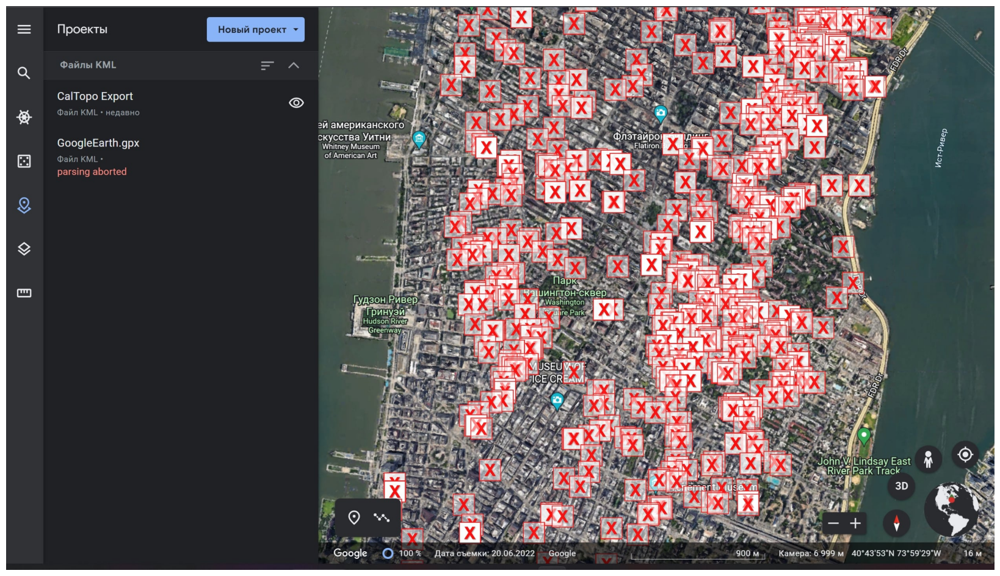

In [98]:
img = cv2.imread("google_maps.jpg") 
draw_picture(img)

Давайте теперь создадим облако слов по features и description

In [45]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
import nltk
import numpy as np
from PIL import Image
path = "C:/Users/Дмитрий/Desktop/plane.jpg"
stop_words = stopwords.words('english')

def draw_cloud(column):
    text = ' '.join(ads_popularity[column])
    cloud = WordCloud(stopwords=stop_words).generate(text)
    cake_mask = np.array(Image.open(path))
    cloud = WordCloud(stopwords=stop_words, mask=cake_mask, contour_width=2, contour_color='#2e3043').generate(text)
    plt.figure(figsize=(18,6))
    plt.imshow(cloud)
    plt.axis('off')

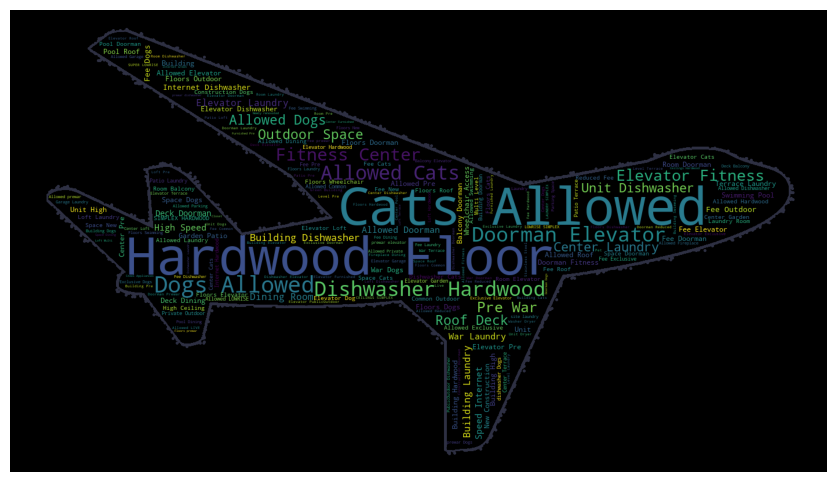

In [46]:
draw_cloud('features')

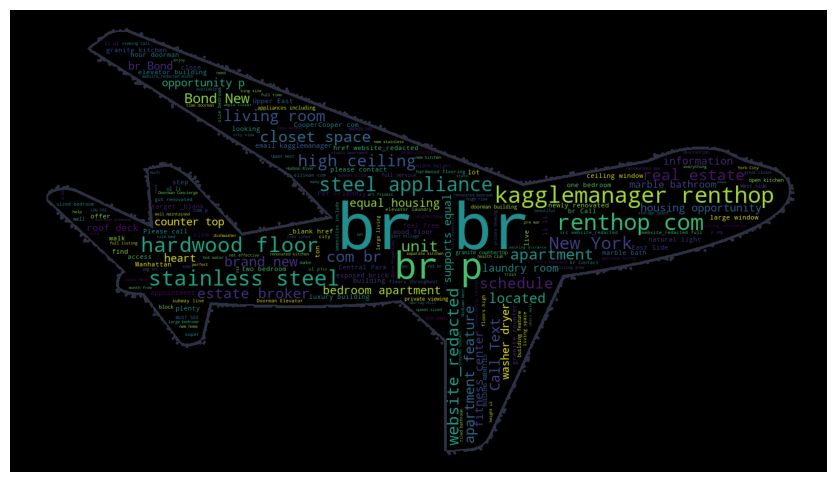

In [47]:
draw_cloud('description')

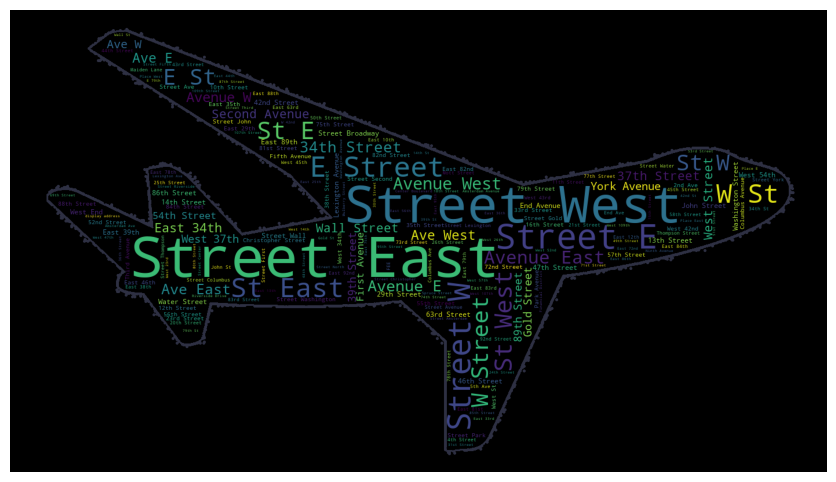

In [48]:
draw_cloud('display_address')

Меня жизнь угораздила попасть в Московский Авиационный Институт..

Видно, что кто-то не убирает разметку. Надо за такое сразу бан выписывать. А ещё кто-то оставляет ссылки на другие сайты, тоже бан.

Посмотрим на все наши фичи, которые мы выделили после EDA. И выберем нужные.

## Feature engineering

In [49]:
ads_popularity.columns

Index(['Id', 'bathrooms', 'bedrooms', 'building_id', 'description',
       'display_address', 'features', 'latitude', 'listing_id', 'longitude',
       'manager_id', 'photos', 'price', 'street_address', 'target',
       'count_features', 'count_photos', 'count_rooms',
       'count_words_in_description', 'day', 'hour', 'minute', 'weekday'],
      dtype='object')

Ванны, спальни, долгота, широта, цена - данные из коробки, я их получил и собираюсь использовать.

features, photos, description - я обработал только лишь по количеству слов(в общем смысле), чтобы из них получить количественный признак

Дату я обработал достаточно однозначно и выкинул то, что не придает никакой уникальности. По дате у меня получилось day, hour, weekday. Предполагаю, что выходные будут тем, на что моделька будет влиять.

Количество комнат - скип, потому что напрямую зависит от количество ванных и спальных комнат 

Минуты в объявлениях - скип, слишком частая характеристика. Интуиция подсказывает, что часов будет вполне достаточно.

В итоге получаем вот такое дело:

In [50]:
numerals = ['bathrooms', 'bedrooms','latitude', 'longitude', 'price',
'count_features', 'count_photos', 'day', 'hour', 'count_words_in_description', 'weekday']
categorials = ["display_address", "manager_id", "building_id", "street_address"]

Категориальных признаков у нас много(очень), кодировать их OneHotEncoding не очень хорошо, как показала моя 9 и 10я домашка. Давайте попробуем просто сопоставить одним адресам - одну цфиру, другим - другую. Так мы сэкономим и рискнем. Лишь бы наша моделька не искала зависимости уже между этими цифрами.

In [51]:
from sklearn import preprocessing
for category in categorials:
    le = preprocessing.LabelEncoder()
    le.fit(ads_popularity[category].to_list())
    ads_popularity[category] = le.transform(ads_popularity[category].to_list())

Теперь давайте сделаем нормальный таргет, а не строки.

In [52]:
ads_popularity['target'] = ads_popularity['target'].map({'high':2, 'medium':1, 'low':0})

## Выбор целевой метрики

**_Accuracy_** - в моём случае доля объявлений по которым классификатор принял правильное решение. Но как мы заметили в EDA, у нас несбалансированные классы. Следовательно мы можем сделать тупую модельку по типу предсказывания всё время low объявлений и у нас будет высокой Accuracy. Однозначно **__такое я выбирать не буду__**

**_Precision_** системы в пределах класса – это доля документов действительно принадлежащих данному классу относительно всех документов которые система отнесла к этому классу. 

**_Recall_** системы – это доля найденных классфикатором документов принадлежащих классу относительно всех документов этого класса в тестовой выборке.

Понятно, что чем выше Precision и Recall, тем лучше. А среди них я не могу дать однозначный ответ, какую использовать. Поэтому я возьму за метрику - **_f1_score_**.\
**_F-мера_** представляет собой гармоническое среднее между точностью и полнотой. Она стремится к нулю, если точность или полнота стремится к нулю. Это ли не прекрасно? Да это просто потрясающе!

## Проведение экспериментов

In [53]:
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split
from sklearn import set_config
set_config(transform_output="pandas")

X = ads_popularity.drop(columns=['Id', 'description', 'features', 'target', 'photos', 'listing_id', 'count_rooms', 'minute'])
y = ads_popularity.target

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.6, random_state=2023)
X_train_new, X_val, y_train_new, y_val = train_test_split(X_train, y_train, train_size=0.5, random_state=2023)

trans = ColumnTransformer(
    [('num', preprocessing.StandardScaler(with_mean=False), numerals + categorials)])

X_train_new_t = trans.fit_transform(X_train_new)
X_train_t = trans.fit_transform(X_train)
X_val_t = trans.fit_transform(X_val)
X_test_t = trans.transform(X_test)

### CatBoost

In [ ]:
from sklearn.metrics import classification_report, f1_score

from catboost import CatBoostClassifier

catboosting = CatBoostClassifier()
catboosting.fit(X_train_new_t, y_train_new, eval_set=[(X_val_t, y_val)])

y_pred_test = catboosting.predict(X_test_t)
y_pred_train = catboosting.predict(X_train_t)

In [55]:
print(classification_report(y_test, y_pred_test))
print(classification_report(y_train, y_pred_train))

              precision    recall  f1-score   support

           0       0.78      0.67      0.72      9603
           1       0.30      0.48      0.37      3138
           2       0.15      0.09      0.12      1078

    accuracy                           0.58     13819
   macro avg       0.41      0.41      0.40     13819
weighted avg       0.62      0.58      0.59     13819

              precision    recall  f1-score   support

           0       0.78      0.75      0.76     14396
           1       0.33      0.44      0.38      4722
           2       0.20      0.09      0.12      1609

    accuracy                           0.62     20727
   macro avg       0.44      0.42      0.42     20727
weighted avg       0.63      0.62      0.62     20727



### XGboost

In [ ]:
from xgboost import XGBClassifier

xgboosting = XGBClassifier()
xgboosting.fit(X_train_new_t, y_train_new, eval_set=[(X_val_t, y_val)])
y_pred_test = xgboosting.predict(X_test_t)
y_pred_train = xgboosting.predict(X_train_t)

In [ ]:
print(classification_report(y_test, y_pred_test))
print(classification_report(y_train, y_pred_train))

              precision    recall  f1-score   support

           0       0.82      0.26      0.39      9603
           1       0.16      0.05      0.08      3138
           2       0.09      0.84      0.17      1078

    accuracy                           0.26     13819
   macro avg       0.36      0.38      0.21     13819
weighted avg       0.61      0.26      0.30     13819

              precision    recall  f1-score   support

           0       0.83      0.47      0.60     14396
           1       0.22      0.08      0.11      4722
           2       0.12      0.80      0.21      1609

    accuracy                           0.41     20727
   macro avg       0.39      0.45      0.31     20727
weighted avg       0.63      0.41      0.46     20727



### lightgbm

In [71]:
from lightgbm import LGBMClassifier

lgboosting = LGBMClassifier(learning_rate=1e-2, random_state=42,)
lgboosting.fit(X_train_new_t, y_train_new)

y_pred_test = lgboosting.predict(X_test_t)
y_pred_train = lgboosting.predict(X_train_t)

In [72]:
print(classification_report(y_test, y_pred_test))
print(classification_report(y_train, y_pred_train))

              precision    recall  f1-score   support

           0       0.86      0.46      0.60      9603
           1       0.24      0.03      0.06      3138
           2       0.11      0.83      0.19      1078

    accuracy                           0.39     13819
   macro avg       0.40      0.44      0.28     13819
weighted avg       0.66      0.39      0.44     13819

              precision    recall  f1-score   support

           0       0.82      0.63      0.72     14396
           1       0.27      0.04      0.07      4722
           2       0.13      0.74      0.23      1609

    accuracy                           0.51     20727
   macro avg       0.41      0.47      0.34     20727
weighted avg       0.64      0.51      0.53     20727



Слабо

### Бэггинг

In [ ]:
from sklearn.ensemble import BaggingClassifier
from sklearn.neighbors import KNeighborsClassifier


bagging_knn = BaggingClassifier(KNeighborsClassifier())
bagging_knn.fit(X_train_new_t, y_train_new)
y_pred_test = bagging_knn.predict(X_test_t)
y_pred_train = bagging_knn.predict(X_train_t)

In [ ]:
print(classification_report(y_test, y_pred_test))
print(classification_report(y_train, y_pred_train))

              precision    recall  f1-score   support

           0       0.78      0.67      0.72      9603
           1       0.30      0.48      0.37      3138
           2       0.15      0.09      0.12      1078

    accuracy                           0.58     13819
   macro avg       0.41      0.41      0.40     13819
weighted avg       0.62      0.58      0.59     13819

              precision    recall  f1-score   support

           0       0.75      0.67      0.71     14396
           1       0.30      0.40      0.34      4722
           2       0.18      0.17      0.17      1609

    accuracy                           0.57     20727
   macro avg       0.41      0.41      0.41     20727
weighted avg       0.60      0.57      0.58     20727



Базовая моделька хорошая, но обучается безумно долго. KNN же.

### RandomForest

Покажу, что умею пользоваться вложенными циклами и перебирать глубину дерева. Потому что я только с Оптюной и CatBoost что-то пытался делать и это вышло долговато!

In [ ]:
from sklearn.ensemble import RandomForestClassifier

f1 =[]
for i in range(2, 12):
    forest = RandomForestClassifier(max_depth=i)
    forest.fit(X_train_new_t, y_train_new)
    y_pred_test = forest.predict(X_test_t)
    y_pred_train = forest.predict(X_train_t)
    f1.append(f1_score(y_pred_test, y_test, average='weighted'))

print(f"Max f1_weighted = {max(f1)}, depth: {(np.array(f1)).argmax() + 2}")

Max f1_weighted = 0.8199982922039109, depth: 2


In [ ]:
forest = RandomForestClassifier(max_depth=2)
forest.fit(X_train_new_t, y_train_new)
y_pred_test = forest.predict(X_test_t)
y_pred_train = forest.predict(X_train_t)

In [ ]:
print(classification_report(y_test, y_pred_test))
print(classification_report(y_train, y_pred_train))

              precision    recall  f1-score   support

           0       0.69      1.00      0.82      9603
           1       0.00      0.00      0.00      3138
           2       0.00      0.00      0.00      1078

    accuracy                           0.69     13819
   macro avg       0.23      0.33      0.27     13819
weighted avg       0.48      0.69      0.57     13819

              precision    recall  f1-score   support

           0       0.69      1.00      0.82     14396
           1       0.00      0.00      0.00      4722
           2       0.00      0.00      0.00      1609

    accuracy                           0.69     20727
   macro avg       0.23      0.33      0.27     20727
weighted avg       0.48      0.69      0.57     20727



Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


Да, у нас лес решило предсказывать всё по low, что вообще не хорошо

### KNN

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier()
knn.fit(X_train_new_t, y_train_new)
y_pred_test = knn.predict(X_test_t)
y_pred_train = knn.predict(X_train_t)

In [ ]:
print(classification_report(y_test, y_pred_test))
print(classification_report(y_train, y_pred_train))

              precision    recall  f1-score   support

           0       0.71      0.58      0.64      9603
           1       0.24      0.41      0.30      3138
           2       0.11      0.07      0.08      1078

    accuracy                           0.50     13819
   macro avg       0.35      0.35      0.34     13819
weighted avg       0.56      0.50      0.52     13819

              precision    recall  f1-score   support

           0       0.74      0.72      0.73     14396
           1       0.30      0.37      0.33      4722
           2       0.16      0.09      0.12      1609

    accuracy                           0.59     20727
   macro avg       0.40      0.39      0.39     20727
weighted avg       0.59      0.59      0.59     20727



А неплохо. Но Catboost не переплюнул.

In [ ]:
from sklearn import tree

tree = tree.DecisionTreeClassifier()
tree.fit(X_train_new_t, y_train_new)

y_pred_test = tree.predict(X_test_t)
y_pred_train = tree.predict(X_train_t)

In [ ]:
print(classification_report(y_test, y_pred_test))
print(classification_report(y_train, y_pred_train))

              precision    recall  f1-score   support

           0       0.92      0.15      0.26      9603
           1       0.26      0.68      0.38      3138
           2       0.06      0.21      0.09      1078

    accuracy                           0.28     13819
   macro avg       0.41      0.35      0.24     13819
weighted avg       0.70      0.28      0.28     13819

              precision    recall  f1-score   support

           0       0.87      0.34      0.48     14396
           1       0.29      0.61      0.39      4722
           2       0.07      0.22      0.11      1609

    accuracy                           0.39     20727
   macro avg       0.41      0.39      0.33     20727
weighted avg       0.67      0.39      0.43     20727



Плохо.

В моём случае CatBoost показал намного лучше результаты. Попробую его потюнить.

Изучив теорию и опыт более старших ребят, тюнить параметры я буду с помощью Optuna, нежели с помощью gridsearchcv.

In [ ]:
import optuna

In [ ]:
def objective(trial):
    param = {
        "objective": trial.suggest_categorical("objective", ["MultiClass", "MultiClassOneVsAll"]),
        "colsample_bylevel": trial.suggest_float("colsample_bylevel", 0.01, 0.1),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.1),
        "depth": trial.suggest_int("depth", 1, 12),
        "boosting_type": trial.suggest_categorical("boosting_type", ["Ordered", "Plain"]),
        "bootstrap_type": trial.suggest_categorical(
            "bootstrap_type", ["Bayesian", "Bernoulli", "MVS"]
        ),
        "used_ram_limit": "3gb",
    }

    if param["bootstrap_type"] == "Bayesian":
        param["bagging_temperature"] = trial.suggest_float("bagging_temperature", 0, 10)
    elif param["bootstrap_type"] == "Bernoulli":
        param["subsample"] = trial.suggest_float("subsample", 0.1, 1)

    gbm = CatBoostClassifier(**param)

    gbm.fit(X_train_new, y_train_new, eval_set=[(X_val, y_val)])

    preds = gbm.predict(X_val)
    f1_scored = f1_score(y_val, preds, average='weighted')
    return f1_scored

In [ ]:
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=50)

In [ ]:
print(f"Number of finished trials: {len(study.trials)}")

print("Best trial:")
trial = study.best_trial

print(f"Value: {trial.value}")

print("Params: ")
for key, value in trial.params.items():
    print(f"    {key}: {value}")

Number of finished trials: 50
Best trial:
Value: 0.5655449421130182
Params: 
    objective: MultiClass
    colsample_bylevel: 0.06984534555218266
    learning_rate: 0.029701605593596678
    depth: 6
    boosting_type: Ordered
    bootstrap_type: MVS


In [ ]:
catboosting.get_all_params()

## Вывод

Я попытался подобрать параметры для XGboost и Castboost. Из моего опыта XGboost подаётся моим подбором и улучшается хотя бы на немного, но catboost улучшить значительно я так и не смог. А это достаточно долго, а дедлайн поджимает :(
Самая лучшая моделька - Catboost, со значительным отрывом и хорошей таблицей скоров.

Если не делать разбитие по трейну/валидации/тест - то значения гораздо лучше. Но нам нужны более реальные для наших объявлений.


 В принципе, можно переходить к анализу ошибок

## Анализ ошибок

In [ ]:
catboosting.get_feature_importance(prettified=True)

,Feature Id,Importances
0,num__price,45.287413
1,num__building_id,15.666965
2,num__hour,10.058322
3,num__bedrooms,7.376310
4,num__count_photos,7.193309
5,num__count_features,2.929243
6,num__count_words_in_description,2.558197
7,num__longitude,1.961512
8,num__day,1.829848
9,num__latitude,1.344383


In [57]:
import shap
from catboost import *

explainer = shap.TreeExplainer(catboosting)
shap_values = explainer.shap_values(Pool(X_train_new_t, y_train_new))

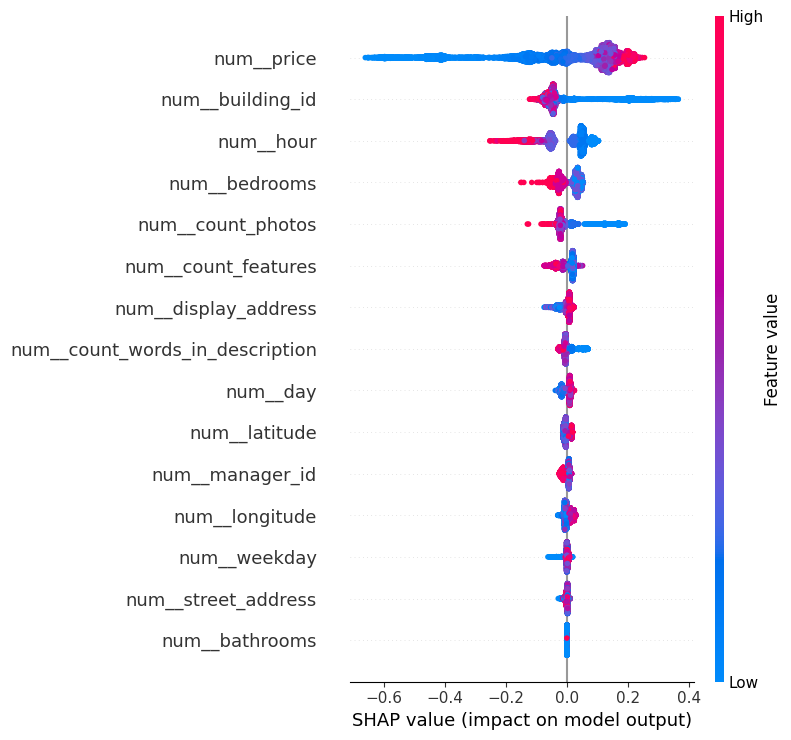

In [59]:
shap.summary_plot(shap_values[0], X_train_new_t)

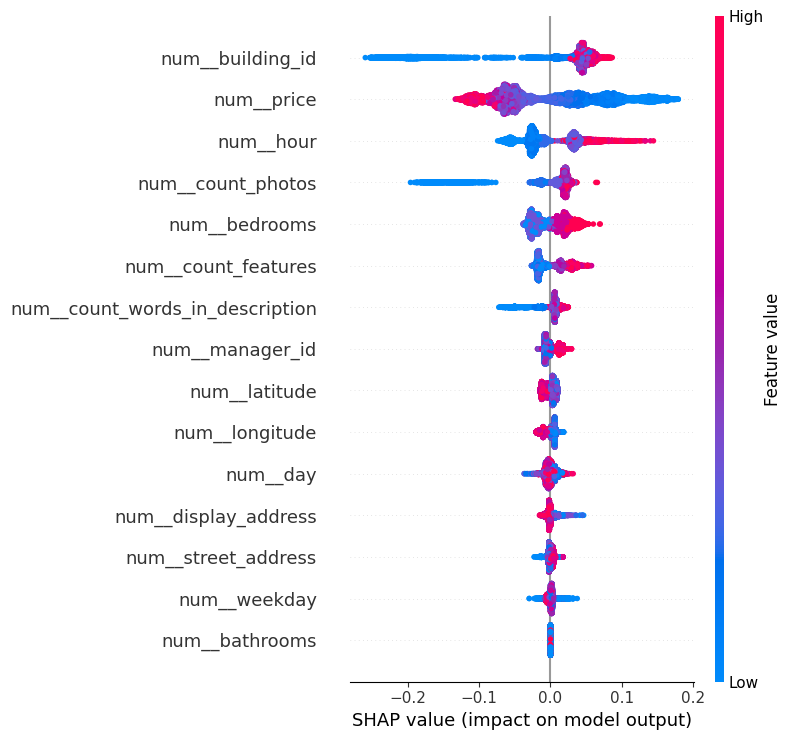

In [ ]:
shap.summary_plot(shap_values[1], X_train_new_t)

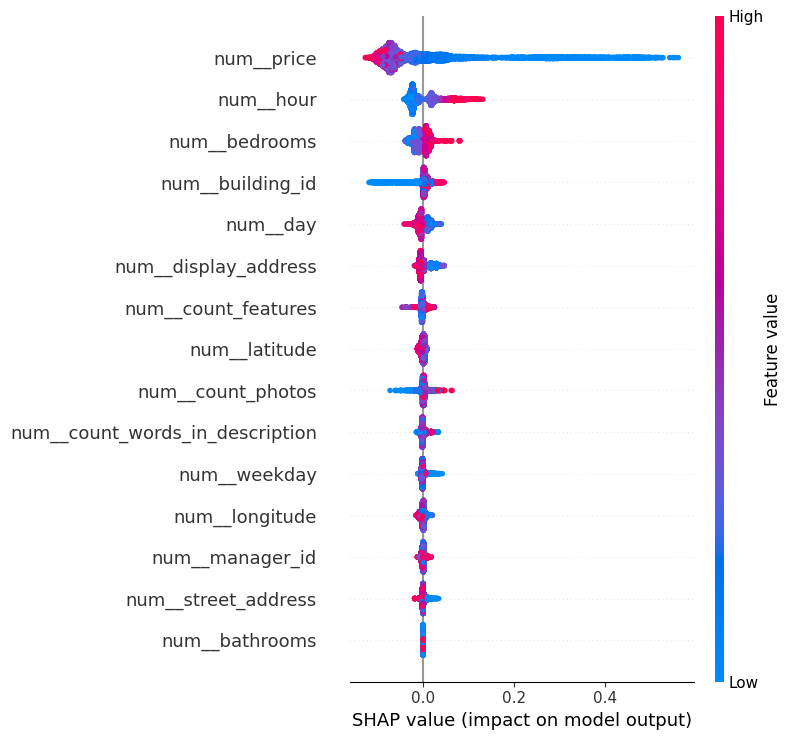

In [60]:
shap.summary_plot(shap_values[2], X_train_new_t)

Всё, в принципе, максимально логично. Цена - влияет так, как должна влиять. Забавно, что Medium от High отличает building_id)

In [64]:
def draw_feature_vizualisation(i):
    print(X_train_new.iloc[i,:])
    print(f'low - {y_train_new.to_list()[i]}')
    shap.initjs()
    return shap.force_plot(explainer.expected_value[0], shap_values[0][i], X_train_new_t.values[i], feature_names = X_train_new.columns)

In [65]:
draw_feature_vizualisation(499)

bathrooms                        1.0000
bedrooms                         0.0000
building_id                   1691.0000
display_address               3986.0000
latitude                        40.7706
longitude                      -73.9501
manager_id                    1724.0000
price                         1725.0000
street_address                9433.0000
count_features                   1.0000
count_photos                     2.0000
count_words_in_description      34.0000
day                             21.0000
hour                             2.0000
weekday                          3.0000
Name: 18374, dtype: float64
low - 0


Рассмотрим это объявление. Ведущий фактор - долгота и время. Ну, действительно, кто в 2 часа ночи будет читать объявления? Не очень хорошо. Спален нет - влияет несильно, вдруг кладовка какая-нибудь. Адрес блатной какой-то)

In [66]:
draw_feature_vizualisation(293)

bathrooms                        1.0000
bedrooms                         1.0000
building_id                   2611.0000
display_address               3650.0000
latitude                        40.7399
longitude                      -73.9812
manager_id                    1493.0000
price                         3000.0000
street_address                3815.0000
count_features                   3.0000
count_photos                     7.0000
count_words_in_description      61.0000
day                             14.0000
hour                             5.0000
weekday                          5.0000
Name: 3549, dtype: float64
low - 2


Спальные комнаты действительно сильно влияют - смотрели в EDA. 5 часов утра - сомнительное время, смотрели и изучали в EDA. Результаты предсказуемые, вполне.